#Data Generation - sampling from 3D GAN

##Importing our libraries and installing dependencies

In [ ]:
!pip install trimesh
!pip install pygame
!pip install mesh_to_sdf
!pip install pydrive 

import numpy as np
import torch
import torch.nn as nn
import matplotlib
from matplotlib import pyplot as plt
import ipywidgets as widgets
import trimesh
from tqdm.notebook import tqdm
import plotly.io as pio
import plotly.graph_objects as go
import pandas as pd
import random
import time
import cv2
import sys
from csv import writer
import os
import scipy.interpolate

##Mounting google drive to create a project folder

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

##Cloning 3D GAN repository
Navigating to project folder to ensure the git clone happens there

In [ ]:
%cd /content/drive/MyDrive/creativeML-FinalProject/
!git clone https://github.com/marian42/shapegan.git

##Importing local libraries from cloned repository

In [ ]:
sys.path.insert(0,'shapegan')

from model.sdf_net import SDFNet
from util import device, standard_normal_distribution, ensure_directory
from rendering.math import get_rotation_matrix

##Helper functions

Function to visualize input mesh

In [ ]:
def visualize_mesh(vertices: np.ndarray, faces: np.ndarray, flatshading: bool = False, height=600, width=600, color="pink"):
  x, y, z = vertices.T
  i, j, k = faces.T
  fig = go.Figure(
      [
          go.Mesh3d(
              x=x,
              y=y,
              z=z,
              i=i,
              j=j,
              k=k,
              color=color
          ),       
      ]
  )

  fig.update_traces(
      flatshading=flatshading, lighting=dict(specular=1.0), selector=dict(type="mesh3d")
  )
  fig.update_layout(
    scene=dict(
        xaxis=dict(visible=False),
        yaxis=dict(visible=False),
        zaxis=dict(visible=False),
    )
)
  fig.update_layout(margin=dict(r=5, l=5, b=5, t=5),height=height, width=width)
  fig.update_layout(scene_aspectmode="data")

  return fig

In [ ]:
%cp ./shapegan/examples/gan_generator_voxels_chairs.to ./models
%cp ./shapegan/examples/gan_generator_voxels_sofas.to ./models

Function to sample objects from 3D GAN generator

In [ ]:
sdf_net = SDFNet()

def sampleFromGAN(chairs_or_sofas, SAMPLE_COUNT, latent_codes):
  if(chairs_or_sofas): 
    sdf_net.filename = 'gan_generator_voxels_chairs.to'
    sdf_net.load()
    sdf_net.eval()

    for i in range(SAMPLE_COUNT):
        ensure_directory('training3dDataset/')
        mesh_filename = f"training3dDataset/chair{i}.obj"

        # latent_code = standard_normal_distribution.sample((128,)).to(device)
        latent_code = latent_codes[i]
        mesh = sdf_net.get_mesh(latent_code, voxel_resolution=256, sphere_only=False, level=0.04)

        mesh.apply_transform(get_rotation_matrix(90, 'x'))
        mesh.apply_translation((0, 0, -np.min(mesh.vertices[:, 2])))
        mesh.export(mesh_filename)

        # print(latent_code)
        # print(latent_code.shape)
        # print(latent_code.min())
        # print(latent_code.max())

        #Writing latentVectors to file

        latentVector = latent_code.tolist()
        # print(latentVector)

        with open('training3dDataset/LatentVectorsChair.csv', mode='a', newline='') as f_object:
          writer_object = writer(f_object)
          writer_object.writerow(latentVector)
          f_object.close()
  else:
      sdf_net.filename = 'gan_generator_voxels_sofas.to'
      sdf_net.load()
      sdf_net.eval()

      for i in range(SAMPLE_COUNT):
          ensure_directory('training3dDataset/')
          mesh_filename = f"training3dDataset/sofa{i}.obj"

          # latent_code = standard_normal_distribution.sample((128,)).to(device)
          latent_code = latent_codes[i]
          mesh = sdf_net.get_mesh(latent_code, voxel_resolution=256, sphere_only=False, level=0.04)

          mesh.apply_transform(get_rotation_matrix(90, 'x'))
          mesh.apply_translation((0, 0, -np.min(mesh.vertices[:, 2])))
          mesh.export(mesh_filename)

          # print(latent_code)
          # print(latent_code.shape)
          # print(latent_code.min())
          # print(latent_code.max())

          #Writing latentVectors to file

          latentVector = latent_code.tolist()
          # print(latentVector)

          with open('training3dDataset/LatentVectorsSofa.csv', mode='a', newline='') as f_object:
            writer_object = writer(f_object)
            writer_object.writerow(latentVector)
            f_object.close()

In [ ]:
def testFromGAN(chairs_or_sofas, SAMPLE_COUNT, latent_codes):
  if(chairs_or_sofas): 
    sdf_net.filename = 'gan_generator_voxels_chairs.to'
    sdf_net.load()
    sdf_net.eval()

    for i in range(SAMPLE_COUNT):
        ensure_directory('training3dDataset/')
        mesh_filename = f"training3dDataset/testChair{i}.obj"

        # latent_code = standard_normal_distribution.sample((128,)).to(device)
        latent_code = latent_codes[i]
        mesh = sdf_net.get_mesh(latent_code, voxel_resolution=256, sphere_only=False, level=0.04)

        mesh.apply_transform(get_rotation_matrix(90, 'x'))
        mesh.apply_translation((0, 0, -np.min(mesh.vertices[:, 2])))
        return mesh

        # print(latent_code)
        # print(latent_code.shape)
        # print(latent_code.min())
        # print(latent_code.max())

        #Writing latentVectors to file

        # latentVector = latent_code.tolist()
        # # print(latentVector)

        # with open('training3dDataset/LatentVectorsChair.csv', mode='a', newline='') as f_object:
        #   writer_object = writer(f_object)
        #   writer_object.writerow(latentVector)
        #   f_object.close()
  else:
      sdf_net.filename = 'gan_generator_voxels_sofas.to'
      sdf_net.load()
      sdf_net.eval()

      for i in range(SAMPLE_COUNT):
          ensure_directory('training3dDataset/')
          mesh_filename = f"training3dDataset/testSofa{i}.obj"

          # latent_code = standard_normal_distribution.sample((128,)).to(device)
          latent_code = latent_codes[i]
          mesh = sdf_net.get_mesh(latent_code, voxel_resolution=256, sphere_only=False, level=0.04)

          mesh.apply_transform(get_rotation_matrix(90, 'x'))
          mesh.apply_translation((0, 0, -np.min(mesh.vertices[:, 2])))
          return mesh

          # print(latent_code)
          # print(latent_code.shape)
          # print(latent_code.min())
          # print(latent_code.max())

          #Writing latentVectors to file

          # latentVector = latent_code.tolist()
          # # print(latentVector)

          # with open('training3dDataset/LatentVectorsSofa.csv', mode='a', newline='') as f_object:
          #   writer_object = writer(f_object)
          #   writer_object.writerow(latentVector)
          #   f_object.close()

##ARSketchNET - Data generation

Choose how many total samples to sample from the 3D GAN generator

In [ ]:
number_of_samples = 1

Choose to sample chairs (True) or sofas (False) from the 3D GAN generator

In [ ]:
chairs_or_sofas = True

Create a latent vector of size 128

In [ ]:
latent_codes = []

for i in range(number_of_samples):
  latent = [random.uniform(-2,2) for i in range(128)]
  latent_code = torch.tensor(latent).to(device)
  latent_codes.append(latent_code)

Sampling from 3D GAN generator

In [ ]:
sampleFromGAN(chairs_or_sofas, number_of_samples, latent_codes)

shapegan/model/sdf_net.py:103: FutureWarning:

marching_cubes_lewiner is deprecated in favor of marching_cubes. marching_cubes_lewiner will be removed in version 0.19



##Visualizing generated meshes

In [ ]:
number_of_meshes = 1

meshes = []

chooser = "chair" if chairs_or_sofas else "sofa"
for i in range(number_of_meshes):
  mesh = trimesh.load_mesh(f"training3dDataset/{chooser}{i}.obj", skip_materials=True)
  meshes.append(mesh)

mesh_visualization = [visualize_mesh(meshes[i].vertices,meshes[i].faces, flatshading=False, width=400, height=400) for i in range(number_of_meshes)]

In [ ]:
mesh_visualization[0].show()

#Sketch2Latent Model (Try 1 : FAIL)
##A model that predicts 3D GAN latent vectors from input sketch sectors from users' drawings

Importing necessary libraries

In [ ]:
from pandas import read_csv
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

Getting Latent Vectors (targets) from dataset

In [ ]:
LV_df = read_csv('XYtest/LatentVectorsChair.csv')
LV_data = LV_df.values
LV_tensor = torch.tensor(LV_data)
LV_tensor.shape

torch.Size([1000, 128])

Getting processed Sketch Vectors (inputs) from dataset

In [ ]:
SV_df = read_csv('XYtest/SketchVectorsChair.csv')
SV_data = SV_df.values
SV_tensor = torch.tensor(SV_data)
SV_tensor.shape

torch.Size([1000, 128])

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(SV_tensor, LV_tensor, test_size=0.3, random_state=32, shuffle=False)

print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

torch.Size([700, 128])
torch.Size([300, 128])
torch.Size([700, 128])
torch.Size([300, 128])


##GridSearchCV : we do a hyperparameter search for KNN with our samples

In [ ]:
reg = KNeighborsRegressor()
param_grid = {'n_neighbors': np.arange(1, 15),
              'weights': ['distance', 'uniform'],
              'p': [1,2,3]}
regGSCV = GridSearchCV(reg, param_grid, cv=5)
regGSCV.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=KNeighborsRegressor(),
             param_grid={'n_neighbors': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14]),
                         'p': [1, 2, 3], 'weights': ['distance', 'uniform']})

Testing with search parameters

In [ ]:
regGSCV.best_params_

{'n_neighbors': 14, 'p': 1, 'weights': 'uniform'}

In [ ]:
regGSCV.best_score_

-0.07481656920981891

In [ ]:
reg = KNeighborsRegressor(n_neighbors = 14, weights = 'uniform', p = 1)
reg.fit(x_train, y_train)
prediction = reg.predict(x_test)
reg.score(x_test, y_test)

-0.06687747890154963

Cross-Validation Accuracy

In [ ]:
cv_scores = cross_val_score(reg, x_test, y_test, cv=5)
print(cv_scores)
print('cv_scores mean:{}'.format(np.mean(cv_scores)))

[-0.08531191 -0.09614362 -0.08824593 -0.09733592 -0.09594916]
cv_scores mean:-0.0925973088074126


##Testing prediction

In [ ]:
prediction = reg.predict(x_test[299:,:])

In [ ]:
prediction.shape

(1, 128)

In [ ]:
index = 0


latent_prediction = torch.tensor(prediction[index].tolist()).to(device)
predicted_mesh = testFromGAN(True, 1, [latent_prediction])

shapegan/model/sdf_net.py:103: FutureWarning:

marching_cubes_lewiner is deprecated in favor of marching_cubes. marching_cubes_lewiner will be removed in version 0.19



In [ ]:
visualize_mesh(predicted_mesh.vertices,predicted_mesh.faces, flatshading=False, width=400, height=400).show()

#Sketch2NeuralImplicit Model (Try 2 : MODERATE SUCCESS :/)

##Importing required libraries

In [ ]:
!pip install trimesh pyDOE PyMCubes &> /dev/null
!pip install -q condacolab &> /dev/null
import condacolab
condacolab.install_from_url("https://repo.anaconda.com/miniconda/Miniconda3-py37_4.11.0-Linux-x86_64.sh")
!conda install -c conda-forge igl &> /dev/null  

In [ ]:
import numpy as np
import torch
import torch.nn as nn
import matplotlib
from matplotlib import pyplot as plt
import ipywidgets as widgets
import trimesh
import igl
import pyDOE as doe
from tqdm.notebook import tqdm
import mcubes
import plotly.io as pio
import plotly.graph_objects as go

##Styling

In [ ]:
# @markdown Styling

import google
is_dark = google.colab.output.eval_js(
    'document.documentElement.matches("[theme=dark]")'
)

matplotlib.rcParams["figure.dpi"] = 100
plt.rcParams["hatch.color"] = "white"

if is_dark:
    # load style sheet for matplotlib, a plotting library we use for 2D visualizations
    plt.style.use(
        "https://github.com/dhaitz/matplotlib-stylesheets/raw/master/pitayasmoothie-dark.mplstyle"
    )
    plt.style.use("dark_background")
    plt.rcParams.update(
        {
            "figure.facecolor": (0.22, 0.22, 0.22, 1.0),
            "axes.facecolor": (0.22, 0.22, 0.22, 1.0),
            "savefig.facecolor": (0.22, 0.22, 0.22, 1.0),
            "grid.color": (0.4, 0.4, 0.4, 1.0),
        }
    )

    plotly_template = pio.templates["plotly_dark"]
    pio.templates["draft"] = go.layout.Template(
        layout=dict(
            plot_bgcolor="rgba(56,56,56,0)",
            paper_bgcolor="rgba(56,56,56,0)",
        )
    )
    pio.templates.default = "plotly_dark+draft"
else:
    plt.style.use(
        "https://github.com/dhaitz/matplotlib-stylesheets/raw/master/pitayasmoothie-light.mplstyle"
    )

##Training data generation from samples meshes - Manual testing for a single chair

Loading the mesh from generated samples

In [ ]:
item_no = 448

test_chair = trimesh.load_mesh(f"training3dDataset/chair{item_no}.obj", skip_materials=True)

Visualizing

In [ ]:
visualize_mesh(test_chair.vertices, test_chair.faces, flatshading=False, width=800, height=800)

Helper functions

In [ ]:
def accept_sample(distance, beta=5):
    acceptance_probability = np.exp(
        -beta * np.abs(distance)
    )
    return np.random.binomial(1, acceptance_probability).astype(
        bool
    )

def get_buffered_bbox(mesh, bbox_relative_buffer=0.05):
    bbox = np.array([[np.min(coords), np.max(coords)] for coords in mesh.vertices.T])
    bbox_extent = bbox[:, 1] - bbox[:, 0]
    buffer = bbox_extent * bbox_relative_buffer
    bbox[:, 0] -= buffer
    bbox[:, 1] += buffer
    return bbox

def get_sdf_samples(n_samples, n_out, mesh, bbox, beta=5):
    # 1. get samples in unit cube
    normalized_samples = doe.lhs(3, n_samples)
    # 2. scale unit cube samples to bbox
    bbox_extent = bbox[:, 1] - bbox[:, 0]
    samples = normalized_samples * (bbox_extent) + bbox[:, 0]
    # 3. compute distances to mesh
    
    distances = igl.signed_distance(samples, mesh.vertices, mesh.faces)[0]
    # 4. normalize distances to allow for consistent filtering irrespectively of object scale
    normalized_distances = distances / np.min(bbox_extent)
    # 5. get a boolean mask of which samples to accept using accept_sample
    sample_mask = accept_sample(normalized_distances, beta=beta)

    accepted_samples = normalized_samples[sample_mask]
    accepted_distances = normalized_distances[sample_mask]

    size_samples = accepted_samples.shape[0]
    selection_idx = random.sample(range(size_samples), n_out)

    return_samples = accepted_samples[selection_idx]
    return_distances = accepted_distances[selection_idx]
    # 6. return a tuple of with the coordinates and distances of the accepted samples
    return return_samples, return_distances

def get_mesh_sdf(normalized_sketch_samples, chairMesh, chairbbox, beta = 5):
    bbox_extent = chairbbox[:, 1] - chairbbox[:, 0]
    samples = normalized_sketch_samples * (bbox_extent) + chairbbox[:, 0]

    distances = igl.signed_distance(samples, chairMesh.vertices, chairMesh.faces)[0]
    normalized_distances = distances / np.min(bbox_extent)
    return normalized_distances

Getting SDF Samples

In [ ]:
geo_idx = 446

sketchMesh = trimesh.load_mesh(f"XYtest/chairSketch446.stl", skip_materials=True)
chairMesh = trimesh.load_mesh(f"training3dDataset/chair446.obj", skip_materials=True)

# sampling_geometry = chairMesh
sampling_geometry = sketchMesh

buffered_bbox = get_buffered_bbox(sampling_geometry)
mesh_samples, mesh_distances = get_sdf_samples(
    100000, 10000, sampling_geometry, buffered_bbox, beta=10
)

In [ ]:
mesh_samples.shape

(10000, 3)

Visualizing samples with distances

In [ ]:
#@title  { run: "auto" }
distance_visibility_threshold = 0.01 #@param {type:"slider", min:0.01, max:1, step:0.05}
distance_filter = np.abs(mesh_distances)<distance_visibility_threshold

training_samples_scatter = go.Scatter3d(
    x=mesh_samples[:,0][distance_filter],
    y=mesh_samples[:,1][distance_filter],
    z=mesh_samples[:,2][distance_filter],
    mode='markers',
    marker=dict(
        size=3,
        color=mesh_distances[distance_filter],
        opacity=1,
        colorbar=dict(thickness=20),
        coloraxis="coloraxis",
    ))


fig = go.Figure(
    [
training_samples_scatter      
    ]
)

# styling
fig.update_layout(
  scene=dict(
      xaxis=dict(visible=False),
      yaxis=dict(visible=False),
      zaxis=dict(visible=False),
  )
)
fig.update_layout(coloraxis=dict(colorscale='Plasma'))
fig.update_layout(margin=dict(r=5, l=5, b=5, t=5),height=800, width=800)
fig.update_layout(scene_aspectmode="data")

In [ ]:
sketch_samples = mesh_samples
sketch_distances = mesh_distances

In [ ]:
sampling_geometry = chairMesh
# sampling_geometry = sketchMesh

buffered_bbox = get_buffered_bbox(sampling_geometry)
chairMesh_distances = get_mesh_sdf(
    sketch_samples, sampling_geometry, buffered_bbox, beta=10
)

In [ ]:
print(chairMesh_distances.shape, sketch_distances.shape)

(10000,) (10000,)


Plotting sketch samples with chairMesh distances

In [ ]:
#@title  { run: "auto" }
distance_visibility_threshold = 0.01 #@param {type:"slider", min:0.01, max:1, step:0.05}
distance_filter = np.abs(chairMesh_distances)<distance_visibility_threshold

training_samples_scatter = go.Scatter3d(
    x=sketch_samples[:,0][distance_filter],
    y=sketch_samples[:,1][distance_filter],
    z=sketch_samples[:,2][distance_filter],
    mode='markers',
    marker=dict(
        size=3,
        color=chairMesh_distances[distance_filter],
        opacity=1,
        colorbar=dict(thickness=20),
        coloraxis="coloraxis",
    ))


fig = go.Figure(
    [
training_samples_scatter      
    ]
)

# styling
fig.update_layout(
  scene=dict(
      xaxis=dict(visible=False),
      yaxis=dict(visible=False),
      zaxis=dict(visible=False),
  )
)
fig.update_layout(coloraxis=dict(colorscale='Plasma'))
fig.update_layout(margin=dict(r=5, l=5, b=5, t=5),height=800, width=800)
fig.update_layout(scene_aspectmode="data")

##Training data generation from samples meshes - generating for whole dataset

In [ ]:
#Loads sketch models, gets samples and distances
def get_sketch_data(index):
  sketchMesh = trimesh.load_mesh(f"sketch3dData/chairSketch{index}.stl", skip_materials=True)

  # sampling_geometry = chairMesh
  sampling_geometry = sketchMesh

  buffered_bbox = get_buffered_bbox(sampling_geometry)
  mesh_samples, mesh_distances = get_sdf_samples(
      100000, 10000, sampling_geometry, buffered_bbox, beta=10
  )
  return mesh_samples, mesh_distances

def get_mesh_data(index, sketch_sample):
  chairMesh = trimesh.load_mesh(f"training3dDataset/chair{index}.obj", skip_materials=True)

  buffered_bbox = get_buffered_bbox(chairMesh)
  chairMesh_distances = get_mesh_sdf(
    sketch_sample, chairMesh, buffered_bbox, beta=10
  )
  return chairMesh_distances

Calculating for all sketch models

In [ ]:
all_sketch_samples = []
all_sketch_distances = []

for i in range(1000):
  ss,sd = get_sketch_data(i)
  all_sketch_samples.append(ss[np.newaxis,...])
  all_sketch_distances.append(sd[np.newaxis,...])

In [ ]:
all_sketch_samples = np.vstack(all_sketch_samples)
all_sketch_distances = np.vstack(all_sketch_distances)

all_sketch_samples.shape, all_sketch_distances.shape

((10, 10000, 3), (10, 10000))

Getting corresponding mesh distance labels for all sketch samples

In [ ]:
all_mesh_distances = []

for i in range(1000):
  md = get_mesh_data(i, all_sketch_samples[i])
  all_mesh_distances.append(md[np.newaxis,...])

In [ ]:
all_mesh_distances = np.vstack(all_mesh_distances)
all_mesh_distances.shape

(10, 10000)

testing plot for a random sample

In [ ]:
choose_item = 0

#@title  { run: "auto" }
distance_visibility_threshold = 0.01 #@param {type:"slider", min:0.01, max:1, step:0.05}
distance_filter = np.abs(all_mesh_distances[choose_item])<distance_visibility_threshold

training_samples_scatter = go.Scatter3d(
    x=all_sketch_samples[choose_item][:,0][distance_filter],
    y=all_sketch_samples[choose_item][:,1][distance_filter],
    z=all_sketch_samples[choose_item][:,2][distance_filter],
    mode='markers',
    marker=dict(
        size=3,
        color=all_mesh_distances[choose_item][distance_filter],
        opacity=1,
        colorbar=dict(thickness=20),
        coloraxis="coloraxis",
    ))


fig = go.Figure(
    [
training_samples_scatter      
    ]
)

# styling
fig.update_layout(
  scene=dict(
      xaxis=dict(visible=False),
      yaxis=dict(visible=False),
      zaxis=dict(visible=False),
  )
)
fig.update_layout(coloraxis=dict(colorscale='Plasma'))
fig.update_layout(margin=dict(r=5, l=5, b=5, t=5),height=800, width=800)
fig.update_layout(scene_aspectmode="data")

##Neural Network Training

We want to train a NN to predict mesh distances (Neural implicit) on sketch samples (Culled Latin Hypercube Sample). So we use input as all_sketch_samples and target as all_mesh_distances

Trying MLP

In [ ]:
class RegressionMLP(nn.Module):
    def __init__(
        self, n_hidden_layers=1, n_hidden_neurons=16, input_dim=1, output_dim=1, activation_function=nn.ReLU
    ):
        super(RegressionMLP, self).__init__()
        self.layer_in = nn.Sequential(nn.Linear(input_dim, n_hidden_neurons), activation_function())
        hidden_layers = []
        for i in range(n_hidden_layers):
            hidden_layers.append(nn.Linear(n_hidden_neurons, n_hidden_neurons))
            hidden_layers.append(activation_function())
        self.layers_mid = nn.Sequential(*hidden_layers)
        self.layer_out = nn.Sequential(nn.Linear(n_hidden_neurons, output_dim))

    def forward(self, x):
        x = self.layer_in(x)
        x = self.layers_mid(x)
        x = self.layer_out(x)

        return x

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
ARSketchNET = RegressionMLP(
    n_hidden_layers=8, n_hidden_neurons=512, input_dim=3, output_dim=1
).to(device)
print(ARSketchNET)

RegressionMLP(
  (layer_in): Sequential(
    (0): Linear(in_features=3, out_features=512, bias=True)
    (1): ReLU()
  )
  (layers_mid): Sequential(
    (0): Linear(in_features=512, out_features=512, bias=True)
    (1): ReLU()
    (2): Linear(in_features=512, out_features=512, bias=True)
    (3): ReLU()
    (4): Linear(in_features=512, out_features=512, bias=True)
    (5): ReLU()
    (6): Linear(in_features=512, out_features=512, bias=True)
    (7): ReLU()
    (8): Linear(in_features=512, out_features=512, bias=True)
    (9): ReLU()
    (10): Linear(in_features=512, out_features=512, bias=True)
    (11): ReLU()
    (12): Linear(in_features=512, out_features=512, bias=True)
    (13): ReLU()
    (14): Linear(in_features=512, out_features=512, bias=True)
    (15): ReLU()
  )
  (layer_out): Sequential(
    (0): Linear(in_features=512, out_features=1, bias=True)
  )
)


In [ ]:
optimizer = torch.optim.Adam(ARSketchNET.parameters(), lr=1e-4)

Creating a dataloader

In [ ]:
all_sketch_samples.T.shape, all_mesh_distances.T.reshape(1,10000,-1).shape

((3, 10000, 10), (1, 10000, 10))

In [ ]:
all_sketch_samples.reshape(-1,3).T.shape, all_mesh_distances.reshape(-1,1).T.shape

((3, 100000), (1, 100000))

In [ ]:
batch_size = 5000

training_dataloader = torch.utils.data.DataLoader(
    torch.Tensor(np.concatenate([all_sketch_samples.reshape(-1,3).T, all_mesh_distances.reshape(-1,1).T]).T),
    shuffle=True,
    batch_size=batch_size,
)

In [ ]:
for sample in training_dataloader:
  x = sample[:, :3].to(device) 
  y = sample[:, 3:].to(device)
  print(x.shape)
  print(y.shape)

torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])
torch.Size([5000, 3])
torch.Size([5000, 1])


Training

In [ ]:
n_epochs = 100

training_losses = []

for i in tqdm(range(n_epochs)):
    for sample in tqdm(training_dataloader):
        optimizer.zero_grad() # reset optimizer gradient
        # get input features (coordinates) and targets (distances)
        x = sample[:, :3].to(device) 
        y = sample[:, 3:].to(device)
        # predict distances using neural network
        y_predicted = ARSketchNET(x)
        # compute L1 Loss
        loss = nn.L1Loss()(y, y_predicted)
        # backprop
        loss.backward()
        # gradient descent step
        optimizer.step()
        # add loss value to list of training losses
        training_losses.append(loss.item())

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

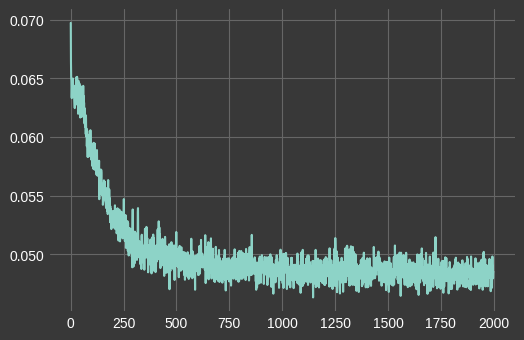

In [ ]:
plt.plot(training_losses)
plt.show()

Test

In [ ]:
test_sample = all_sketch_samples[8]

In [ ]:
sdf = ARSketchNET.to("cpu")(torch.Tensor(test_sample))
sdf = sdf.detach().cpu().numpy()

In [ ]:
sdf.shape

(10000, 1)

In [ ]:
#@title  { run: "auto" }
distance_visibility_threshold = 0.01 #@param {type:"slider", min:0.01, max:1, step:0.05}
distance_filter = np.abs(sdf.flatten())<distance_visibility_threshold

training_samples_scatter = go.Scatter3d(
    x=test_sample[:,0][distance_filter],
    y=test_sample[:,1][distance_filter],
    z=test_sample[:,2][distance_filter],
    mode='markers',
    marker=dict(
        size=3,
        color=sdf.flatten()[distance_filter],
        opacity=1,
        colorbar=dict(thickness=20),
        coloraxis="coloraxis",
    ))


fig = go.Figure(
    [
training_samples_scatter      
    ]
)

# styling
fig.update_layout(
  scene=dict(
      xaxis=dict(visible=False),
      yaxis=dict(visible=False),
      zaxis=dict(visible=False),
  )
)
fig.update_layout(coloraxis=dict(colorscale='Plasma'))
fig.update_layout(margin=dict(r=5, l=5, b=5, t=5),height=800, width=800)
fig.update_layout(scene_aspectmode="data")

#Point2Point using PointNET (Try 3 : SUCCESS!!)